# Importación de librerias

In [1]:
import numpy as np
import pandas as pd
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns
import plotly.express as px

# Importación de datos

In [2]:
df=pd.read_csv("players_21.csv")
df.head()

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club_name,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,33,1987-06-24,170,72,Argentina,FC Barcelona,...,66+3,65+3,65+3,65+3,66+3,62+3,52+3,52+3,52+3,62+3
1,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,35,1985-02-05,187,83,Portugal,Juventus,...,65+3,61+3,61+3,61+3,65+3,61+3,54+3,54+3,54+3,61+3
2,200389,https://sofifa.com/player/200389/jan-oblak/210002,J. Oblak,Jan Oblak,27,1993-01-07,188,87,Slovenia,Atlético Madrid,...,32+3,36+3,36+3,36+3,32+3,32+3,33+3,33+3,33+3,32+3
3,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,31,1988-08-21,184,80,Poland,FC Bayern München,...,64+3,65+3,65+3,65+3,64+3,61+3,60+3,60+3,60+3,61+3
4,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,28,1992-02-05,175,68,Brazil,Paris Saint-Germain,...,67+3,62+3,62+3,62+3,67+3,62+3,49+3,49+3,49+3,62+3


In [3]:
df.columns.to_list()

['sofifa_id',
 'player_url',
 'short_name',
 'long_name',
 'age',
 'dob',
 'height_cm',
 'weight_kg',
 'nationality',
 'club_name',
 'league_name',
 'league_rank',
 'overall',
 'potential',
 'value_eur',
 'wage_eur',
 'player_positions',
 'preferred_foot',
 'international_reputation',
 'weak_foot',
 'skill_moves',
 'work_rate',
 'body_type',
 'real_face',
 'release_clause_eur',
 'player_tags',
 'team_position',
 'team_jersey_number',
 'loaned_from',
 'joined',
 'contract_valid_until',
 'nation_position',
 'nation_jersey_number',
 'pace',
 'shooting',
 'passing',
 'dribbling',
 'defending',
 'physic',
 'gk_diving',
 'gk_handling',
 'gk_kicking',
 'gk_reflexes',
 'gk_speed',
 'gk_positioning',
 'player_traits',
 'attacking_crossing',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed

# Transformación de datos

In [4]:
to_drop = ['dob','sofifa_id','player_url','long_name','body_type','real_face',
           'nation_position','loaned_from','nation_jersey_number']
df = df.drop(to_drop, axis=1)

In [5]:
df =  pd.concat([df,df['player_positions'].str.get_dummies(sep=',').add_prefix('Position-')],axis = 1)
df =  df.drop('player_positions',axis=1)

In [6]:
to_change = ['ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb','ldm',
           'cdm','rdm','rwb','lb','lcb','cb','rcb','rb']
for c in to_change:
    df[c] = df[c].str.split('+',n=1,expand = True)[0].astype('int64')

In [7]:
df.fillna(0, inplace=True)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18944 entries, 0 to 18943
Columns: 125 entries, short_name to Position-ST
dtypes: float64(17), int64(98), object(10)
memory usage: 18.1+ MB


# Gráficos

<AxesSubplot:>

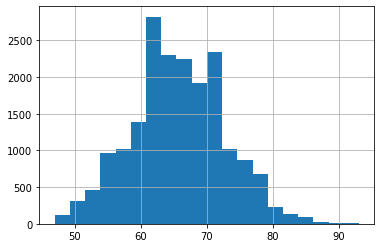

In [9]:
df['overall'].hist(bins = 20)

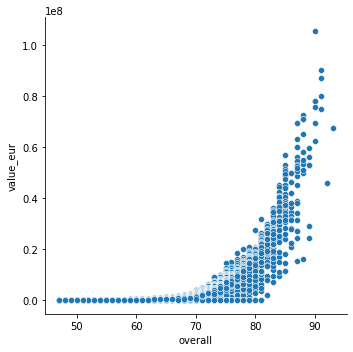

In [10]:
sns.relplot(data=df, x='overall', y='value_eur')

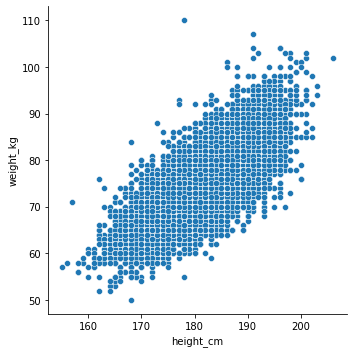

In [11]:
sns.relplot(data=df, x='height_cm', y='weight_kg')

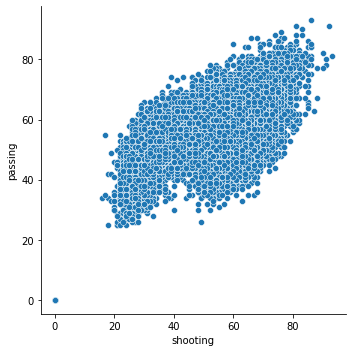

In [12]:
sns.relplot(data=df, x='shooting', y='passing')

In [13]:
gk_cols = [col for col in df.columns if 'gk' in col]
attacking_cols = [col for col in df.columns if 'attacking' in col]
skill_cols = [col for col in df.columns if 'skill' in col]
movement_cols = [col for col in df.columns if 'movement' in col]
power_cols = [col for col in df.columns if 'power' in col]
mentality_cols = [col for col in df.columns if 'mentality' in col]
defending_cols = [col for col in df.columns if 'defending' in col]
goalkeeping_cols = [col for col in df.columns if 'goalkeeping' in col]

habilidades = [gk_cols, attacking_cols, skill_cols, movement_cols, power_cols,
               mentality_cols, defending_cols, goalkeeping_cols]

In [14]:
df['gk_mean'] = df[gk_cols].mean(axis=1)
df['attacking_mean'] = df[attacking_cols].mean(axis=1)
df['skill_mean'] = df[skill_cols].mean(axis=1)
df['movement_mean'] = df[movement_cols].mean(axis=1)
df['power_mean'] = df[power_cols].mean(axis=1)
df['mentality_mean'] = df[mentality_cols].mean(axis=1)
df['defending_mean'] = df[defending_cols].mean(axis=1)
df['goalkeeping_mean'] = df[goalkeeping_cols].mean(axis=1)

In [15]:
mean_cols = [col for col in df.columns if '_mean' in col]

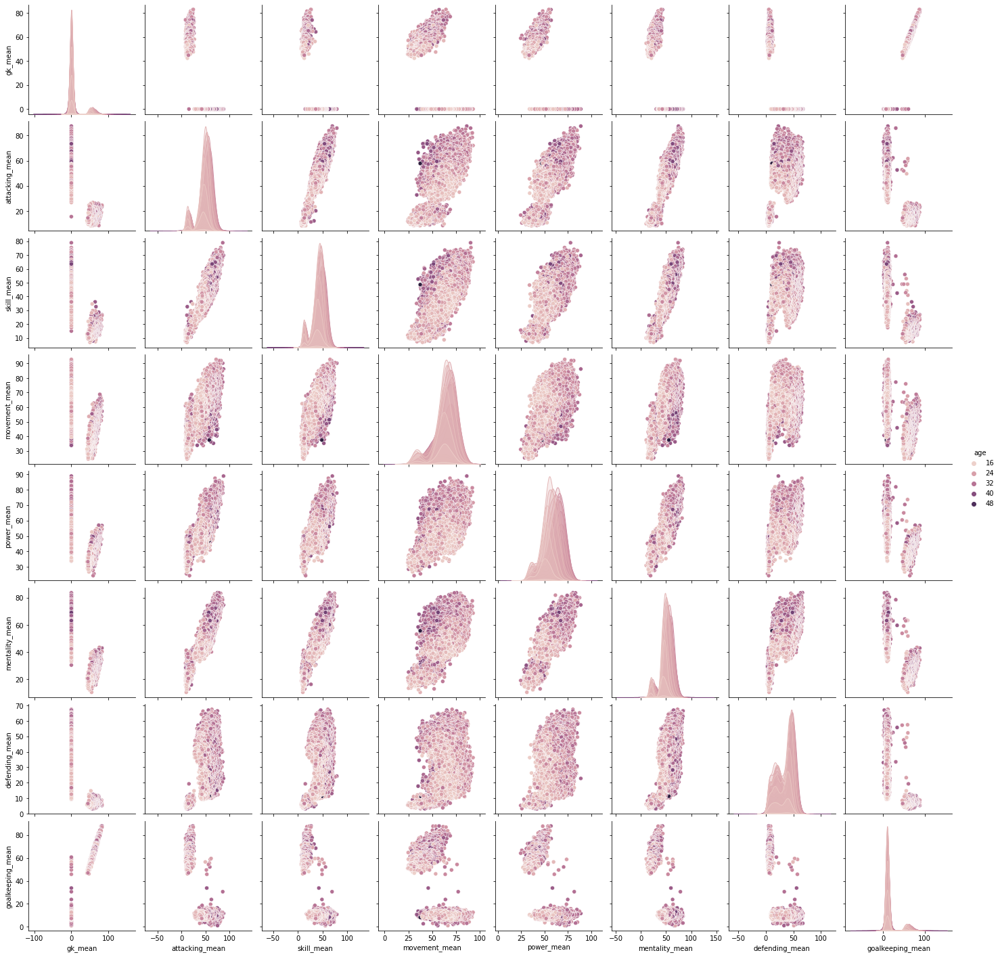

In [16]:
sns.pairplot(data=df, vars=mean_cols, hue='age')

In [17]:
df['gk_mean'] = df[gk_cols].mean(axis=1)
df['attacking_mean'] = df[attacking_cols].mean(axis=1)
df['skill_mean'] = df[skill_cols].mean(axis=1)
df['movement_mean'] = df[movement_cols].mean(axis=1)
df['power_mean'] = df[power_cols].mean(axis=1)
df['mentality_mean'] = df[mentality_cols].mean(axis=1)
df['defending_mean'] = df[defending_cols].mean(axis=1)
df['goalkeeping_mean'] = df[goalkeeping_cols].mean(axis=1)

<AxesSubplot:xlabel='goalkeeping_mean', ylabel='value_eur'>

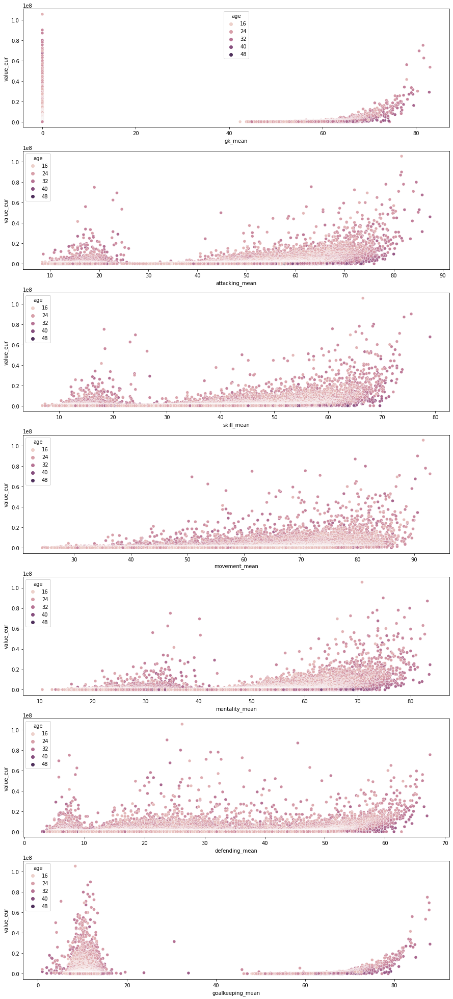

In [18]:
fig, axs = plt.subplots(nrows=7, ncols=1, figsize=(15,35))

sns.scatterplot(data=df, x='gk_mean', y='value_eur', hue="age", ax=axs[0])
sns.scatterplot(data=df, x='attacking_mean', y='value_eur', hue="age", ax=axs[1])
sns.scatterplot(data=df, x='skill_mean', y='value_eur', hue="age", ax=axs[2])
sns.scatterplot(data=df, x='movement_mean', y='value_eur', hue="age", ax=axs[3])
sns.scatterplot(data=df, x='mentality_mean', y='value_eur', hue="age", ax=axs[4])
sns.scatterplot(data=df, x='defending_mean', y='value_eur', hue="age", ax=axs[5])
sns.scatterplot(data=df, x='goalkeeping_mean', y='value_eur', hue="age", ax=axs[6])

In [19]:
df.corr()["value_eur"].sort_values(ascending=False)[:10]

value_eur                   1.000000
release_clause_eur          0.984996
wage_eur                    0.840126
overall                     0.630085
potential                   0.571925
international_reputation    0.564192
movement_reactions          0.558071
mentality_composure         0.447076
mentality_vision            0.366410
power_shot_power            0.354212
Name: value_eur, dtype: float64

# Clustering KMeans

In [20]:
skills = [item for sublist in habilidades for item in sublist]

In [21]:
n=10000
df_n=df.loc[:n] #los primeros n
df_n=df_n[(df_n['overall']>70)] # mejores jugadores

df_skills = df_n[mean_cols]

In [22]:
from sklearn.cluster import KMeans
from sklearn import decomposition

In [23]:
# Número de clusters buscado
n_clust = 5

km = KMeans(n_clusters=n_clust)
km.fit(df_skills) #utiliza todas las habilidades: 42 dimensiones

# Recuperacion de etiquetas
clusters = km.labels_
print('Suma de los cuadrados de las distancias al cluster=Inertia= ', km.inertia_)

Suma de los cuadrados de las distancias al cluster=Inertia=  782171.7597260057


Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

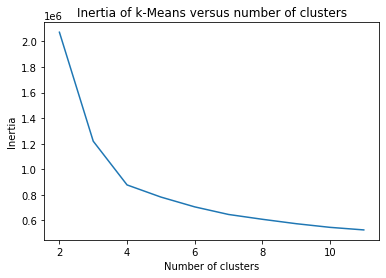

In [24]:
#Prueba: para elegir el hiperparámetro n_clusters, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(df_skills).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [25]:
mean_cols

['gk_mean',
 'attacking_mean',
 'skill_mean',
 'movement_mean',
 'power_mean',
 'mentality_mean',
 'defending_mean',
 'goalkeeping_mean']

In [26]:
bool_crack=df_n["overall"] > 85
bool_no_crack=df_n["overall"]<86

#Eligo dos números entre 0 y  de n_skills-1
skill_1=mean_cols[3]
skill_2=mean_cols[4]

In [27]:
import itertools
skill_combos = set(itertools.combinations(mean_cols, 2))

In [29]:
def plot_clusters(df_skills, skill_1, skill_2):
    kmean_clusters = go.Scatter(x=df_skills[skill_1], y=df_skills[skill_2],
                               mode='markers',
                            text=df_n.loc[:,'short_name'],
                               marker=dict(
                                    size=5,
                                    color = clusters.astype(np.float), #set color equal to a variable
                                    colorscale='Portland',
                                    showscale=False)
                               )

    crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Ckacks!!',
                          text=df_n.loc[bool_crack,'short_name'],
                          textfont=dict(family='sans serif',size=10,color='black'),
                          opacity=0.9,mode='text')

    data=[kmean_clusters,crack]

    layout = go.Layout(title=f"{skill_1} vs {skill_2}",titlefont=dict(size=20),
                    xaxis=dict(title=skill_1),
                    yaxis=dict(title=skill_2),
                    autosize=False, width=1000,height=650)

    fig = go.Figure(data=data, layout=layout)
    fig.show()

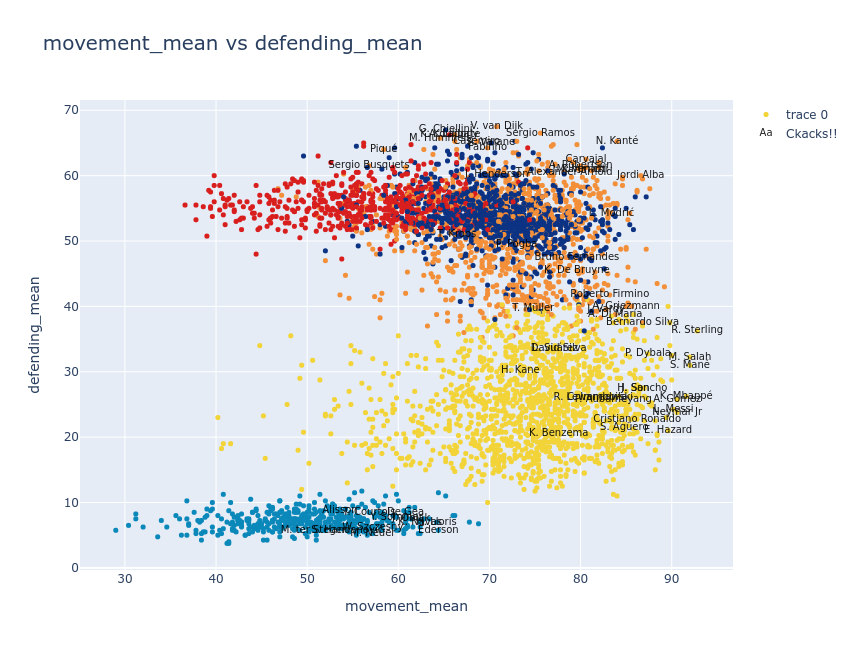

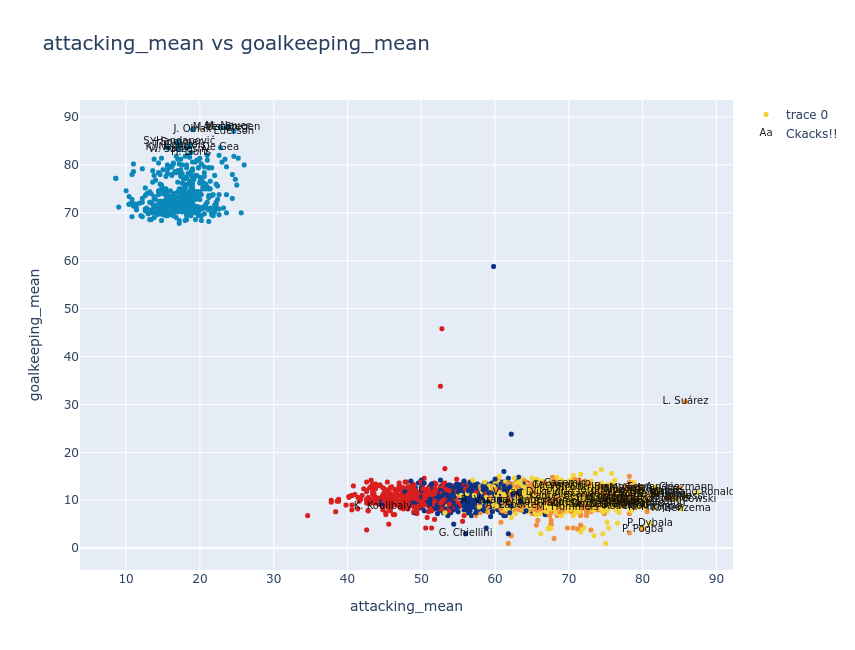

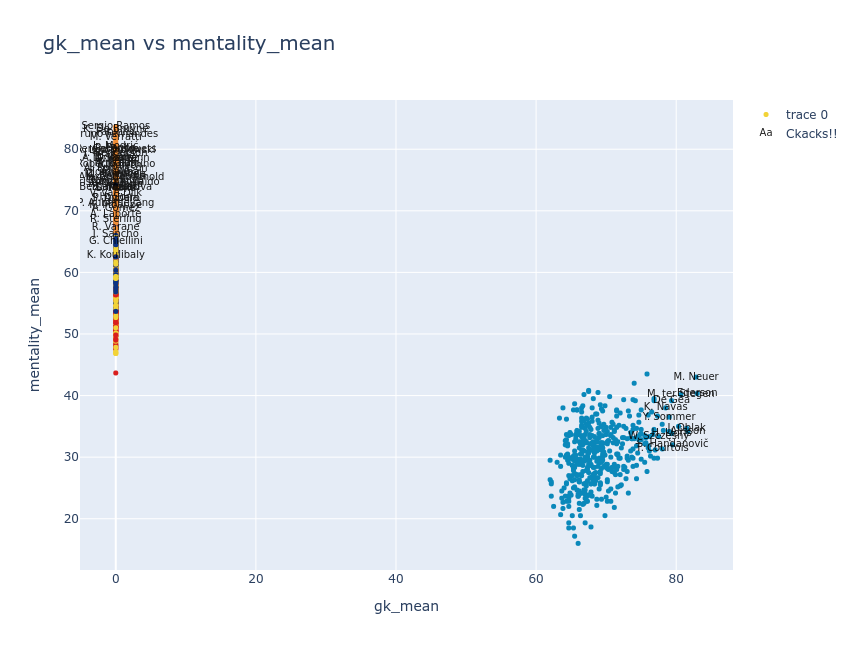

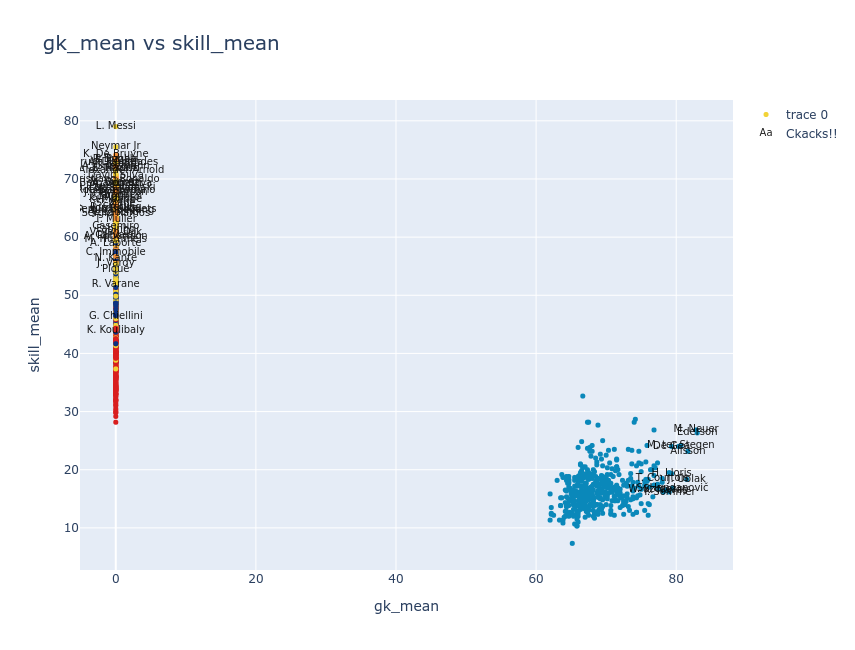

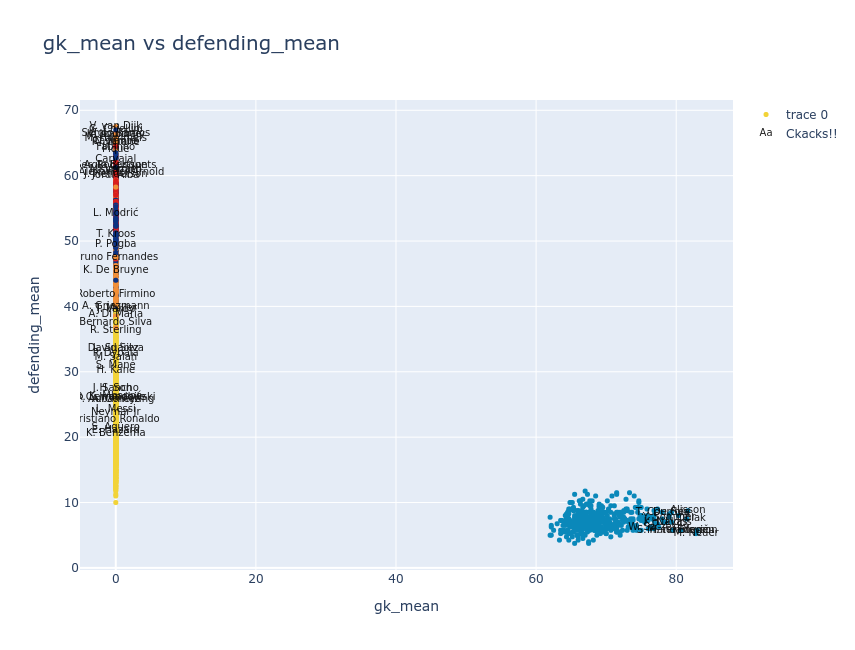

...

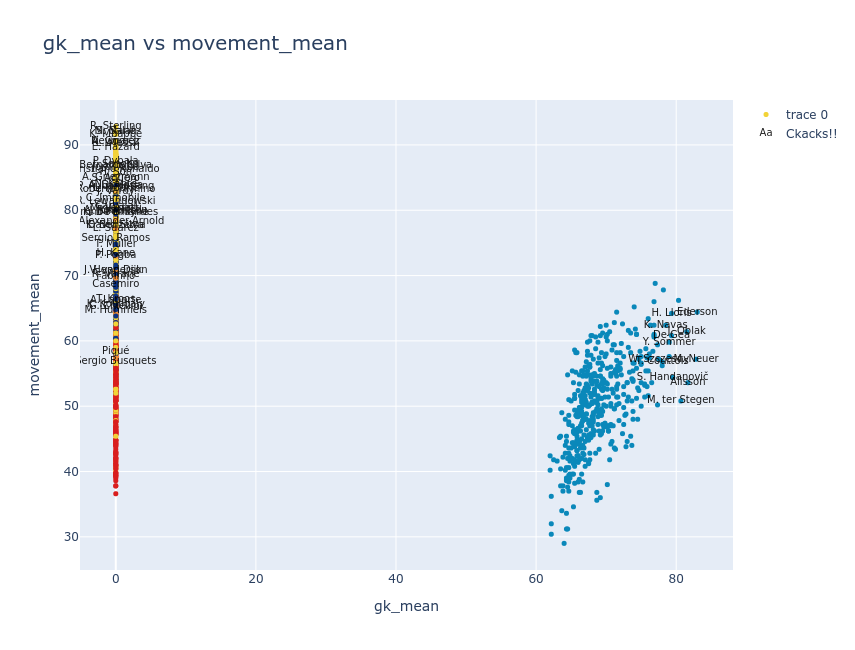

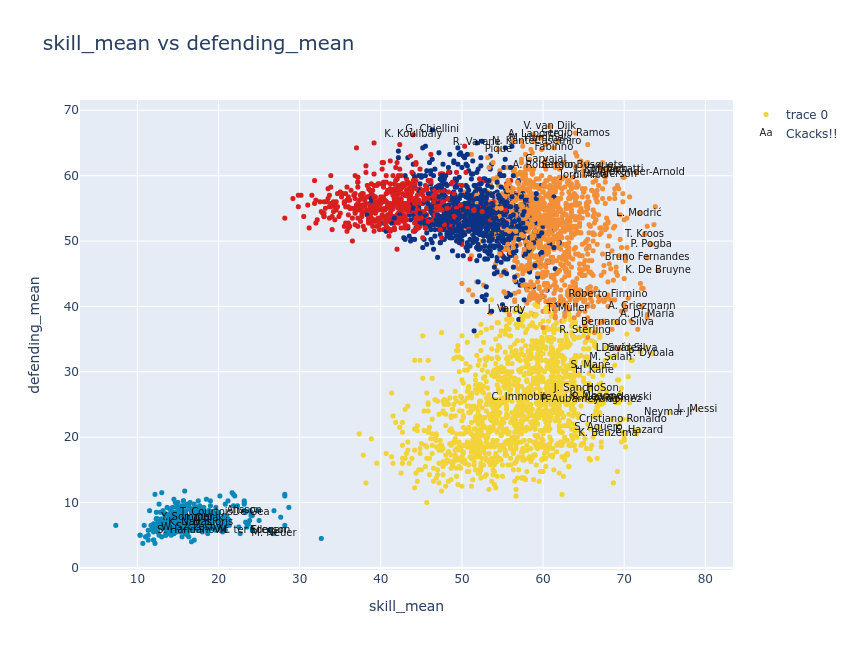

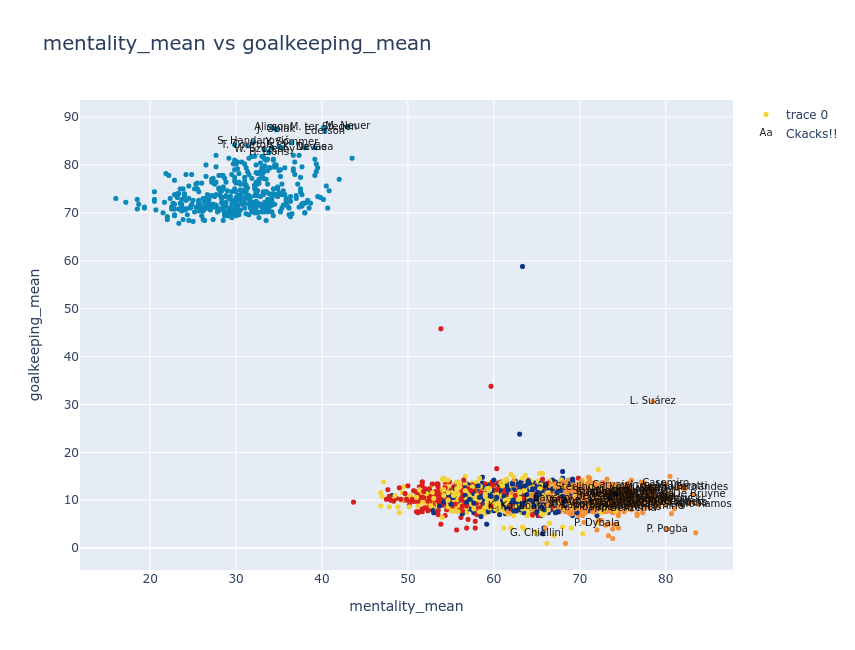

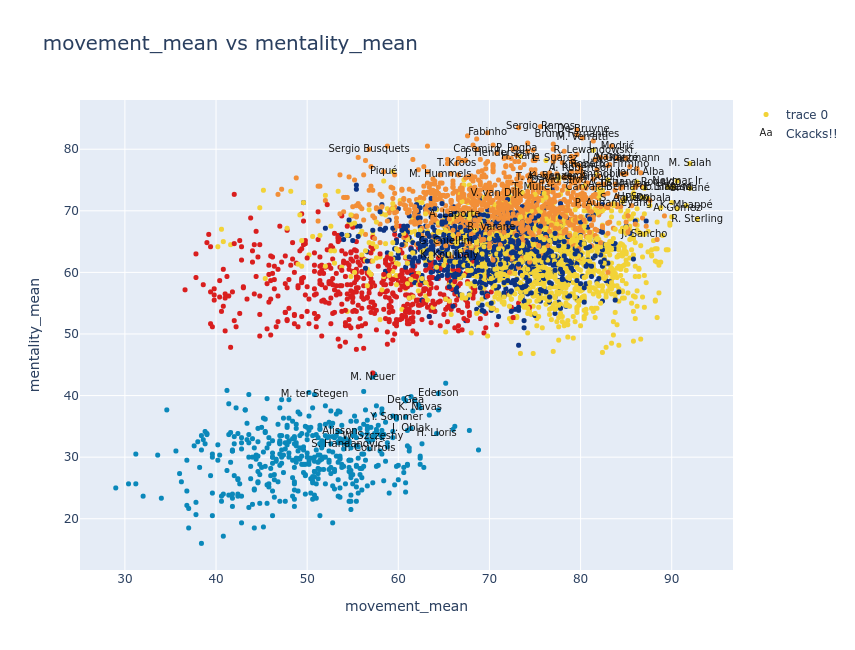

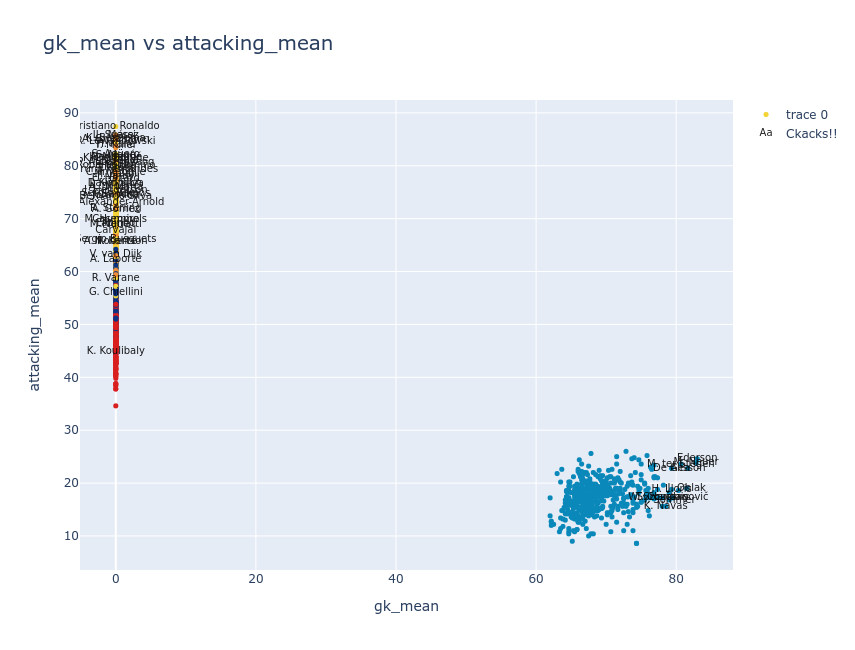

In [31]:
for sc in skill_combos:
    plot_clusters(df_skills, sc[0], sc[1])